In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import sys
data_path = "../../../TabulaSapiensData/"
ts_path = "../"
sys.path.append(ts_path)


In [3]:
import matplotlib.pyplot as plt

%matplotlib inline

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


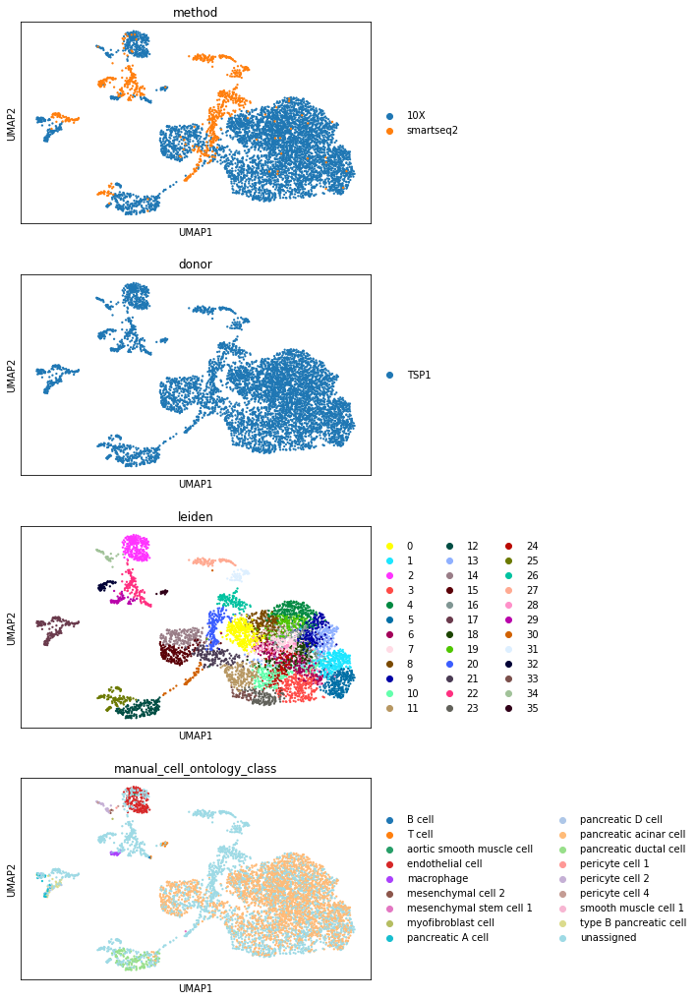

In [5]:
organ = "Pancreas"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

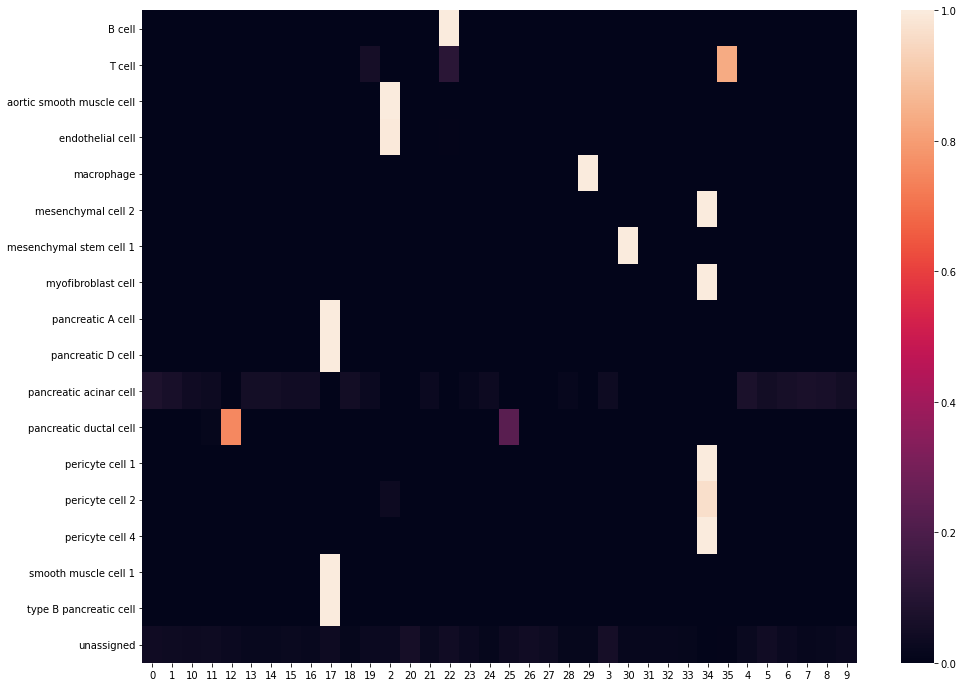

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['pancreatic acinar cell: 0.66', 'unassigned: 0.34']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


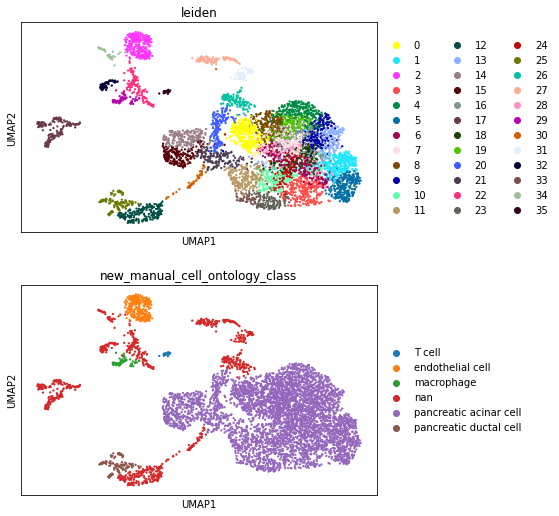

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [14]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{pancreatic acinar cell},"{pancreatic acinar cell, T cell}"
1,{pancreatic acinar cell},{pancreatic acinar cell}
2,{endothelial cell},"{pericyte cell 2, endothelial cell, T cell}"
3,{pancreatic acinar cell},{pancreatic acinar cell}
4,{pancreatic acinar cell},{pancreatic acinar cell}
5,{pancreatic acinar cell},{pancreatic acinar cell}
6,{pancreatic acinar cell},{pancreatic acinar cell}
7,{pancreatic acinar cell},{pancreatic acinar cell}
8,{pancreatic acinar cell},{pancreatic acinar cell}


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


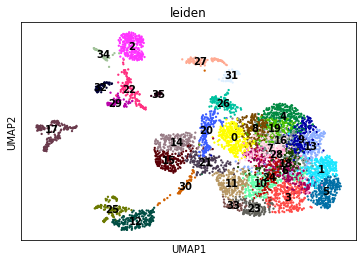

In [15]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")

# Sankey Diagram between cluster and compartment

In [16]:
from utils.colorDict import (
    donor_colors,
    method_colors,
    compartment_colors,
    tissue_colors,
)

In [17]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [18]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Pancreas.html'

# visualize compartment markers

In [19]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [20]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



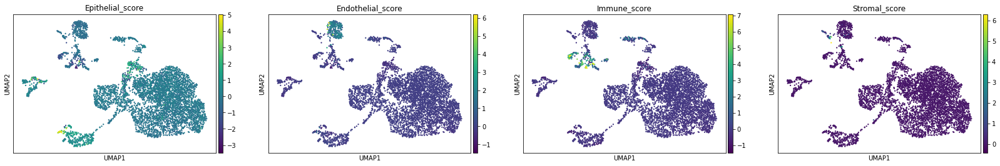

In [21]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [22]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [23]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [24]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [25]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]


,0,1,2,3,4,5,6,7,8,9,...,26,27,28,29,30,31,32,33,34,35
0,AMY2A,CTRL,RAMP2,RPL9P9,HMGCS2,CTRL,CEL,SCG5,CTRL,PDIA4,...,GATM,AL512646.1,CEL,HLA-DPA1,MALAT1,AL512646.1,TPSB2,IL32,TPM2,CORO1A
1,CTRL,PRSS1,PECAM1,LENG8,SCG5,CELA2B,RPL9P9,GPHA2,AMY2A,HYOU1,...,ERP27,S100A9,PRSS2,HLA-DPB1,RBPJL,RPL3P4,TPSAB1,REG1B,CALD1,PTPRC
2,PRSS2,RNASE1,IFI27,CEL,FREM2-AS1,PRSS1,INSR,REG3G,PRSS2,MANF,...,SERPINI2,MALAT1,IGFBP2,HLA-DRA,AC092979.1,RPL21P28,CPA3,GSTA1,LGALS1,CCL5
3,CELA2B,SYCN,IGFBP4,MT-ND3,TRIM29,CEL,TKT,CTRB2,CELA2B,HSPA5,...,ANPEP,NAMPT,RPL9P9,CD74,AC009078.2,RPL6P27,CAPG,RAB11FIP1,IGFBP7,ARHGDIB
4,PLA2G1B,SERPINI2,PLVAP,PCBP2,NANP,PRSS2,GAS5,INSIG1,CEL,HSP90B1,...,CPB1,CSF3R,PLA2G1B,HLA-DRB1,AL512646.1,AC113935.1,ARHGDIB,REG3A,SPARCL1,S100A4
5,CELA2A,NUCB2,SPARCL1,RPS29,PLAC8L1,PLA2G1B,SLC25A5,ENPP1,CELA2A,PSAT1,...,PNLIPRP2,SAT1,PPIB,LAPTM5,GOLGA8B,MT-ATP8,ACTB,SERPINB1,MFGE8,CD7
6,AL034369.1,CELA2B,FABP5,RPL41P2,AP000281.1,SYCN,FAM129A,LGALS2,PRSS1,INSIG1,...,PNLIPRP1,IFITM2,PDIA2,ARHGDIB,RN7SL186P,RPL13AP5,TPSD1,FSCN2,NR2F2,TRBC2
7,CELA3B,PRSS2,SPARC,RPL39,AC124045.1,RPL9P9,NOP53,AL365226.2,PRSS3,SLC16A10,...,PNLIP,S100A8,PRDX4,ARPC3,CUZD1,MT-ND6,KIT,REG3G,COL6A2,HLA-C
8,PNLIP,PLA2G1B,CD320,SNRNP70,PCDHA6,HSPA1A,AZGP1,PACSIN2,PLA2G1B,SEL1L,...,CPA1,FYB1,SEC11C,PTPRC,RN7SL386P,MT-TP,B2M,GAS5,PLAC9,CD69
9,CEL,CEL,A2M,RPL37,AC073842.1,KLK1,EEF1D,LINC00632,CPA1,SSR1,...,AMY2A,LUCAT1,PNLIPRP2,LCP1,MTCO2P2,CELA2A,FTH1P20,MTHFD2,MGP,CYTIP


In [26]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
AMY2A,15.320601,1.699005,3.279080e-48
CTRL,14.726482,1.962728,1.282803e-44
PRSS2,14.331129,2.759146,2.743897e-42
CELA2B,14.157248,2.133706,2.479337e-41
PLA2G1B,13.475057,2.398213,2.582227e-37
CELA2A,13.195816,1.912366,9.099816e-36
AL034369.1,12.804837,1.078688,1.295546e-33
CELA3B,12.663596,1.620887,6.923724e-33
PNLIP,12.439597,2.466924,1.042033e-31
CEL,12.149622,2.314119,3.392770e-30


1


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,16.746416,2.310187,3.540558e-58
PRSS1,16.025906,3.244987,2.480061e-53
RNASE1,15.816381,1.797177,4.707489e-52
SYCN,15.421027,2.728121,1.739734e-49
SERPINI2,15.318747,1.669392,6.747907e-49
NUCB2,15.290355,1.477629,8.699654e-49
CELA2B,15.206389,2.355432,2.697530e-48
PRSS2,15.149699,2.976104,5.601044e-48
PLA2G1B,15.114602,2.672739,8.487289e-48
CEL,14.988360,2.646687,4.907611e-47


2


,wilcoxon_score,log fold change,adjusted pvalue
RAMP2,27.127018,10.542791,2.783519e-157
PECAM1,27.071421,9.398241,6.291776e-157
IFI27,27.012978,10.741876,2.041685e-156
IGFBP4,26.854954,9.355264,1.086522e-154
PLVAP,26.833229,12.570099,1.558728e-154
SPARCL1,26.757954,8.980096,9.789951e-154
FABP5,26.556517,9.010203,1.816264e-151
SPARC,26.482740,8.773648,1.127406e-150
CD320,26.451868,6.815677,2.271423e-150
A2M,26.445038,7.753967,2.449718e-150


3


,wilcoxon_score,log fold change,adjusted pvalue
RPL9P9,22.691286,2.468942,3.215348e-109
LENG8,21.353485,2.671033,1.065289e-96
CEL,21.259977,3.390390,5.230396e-96
MT-ND3,21.026394,2.829507,5.536446e-94
PCBP2,20.839903,2.288396,2.216147e-92
RPS29,20.666054,2.154835,6.869237e-91
RPL41P2,20.586992,2.596956,3.018944e-90
RPL39,20.348160,2.308515,3.547104e-88
SNRNP70,20.279652,2.292837,1.272268e-87
RPL37,20.252155,2.163708,2.001770e-87


4


,wilcoxon_score,log fold change,adjusted pvalue
HMGCS2,1.058385,0.112104,1.0
SCG5,0.964390,-0.828612,1.0
FREM2-AS1,0.472359,0.361263,1.0
TRIM29,0.281053,4.156417,1.0
NANP,0.266153,0.328109,1.0
PLAC8L1,0.237188,3.284168,1.0
AP000281.1,0.232571,2.210042,1.0
AC124045.1,0.222270,1.714845,1.0
PCDHA6,0.222037,0.954960,1.0
AC073842.1,0.212375,0.986088,1.0


5


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,22.913195,3.371627,2.020606e-111
CELA2B,21.911791,3.565593,5.902824e-102
PRSS1,21.771475,4.336432,8.486943e-101
CEL,21.751143,3.514030,9.916623e-101
PRSS2,21.481434,4.154342,2.734286e-98
PLA2G1B,21.308578,3.768634,9.274195e-97
SYCN,21.257011,3.798188,2.387861e-96
RPL9P9,21.074944,2.279756,9.939253e-95
HSPA1A,21.055021,2.949333,1.345472e-94
KLK1,20.795515,3.122909,2.797664e-92


6


,wilcoxon_score,log fold change,adjusted pvalue
CEL,14.502057,2.683890,5.774355e-43
RPL9P9,14.466879,1.481535,5.774355e-43
INSR,13.898569,1.447152,1.268068e-39
TKT,13.643904,1.333625,3.230342e-38
GAS5,13.614711,1.356994,3.855250e-38
SLC25A5,13.442471,1.095093,3.344456e-37
FAM129A,13.370193,1.449870,7.594781e-37
NOP53,13.303544,1.288464,1.624462e-36
AZGP1,13.178272,1.458076,7.655769e-36
EEF1D,13.161467,1.418488,8.423968e-36


7


,wilcoxon_score,log fold change,adjusted pvalue
SCG5,2.399995,-0.263841,0.374831
GPHA2,2.349376,0.005937,0.408186
REG3G,2.175922,0.194516,0.543153
CTRB2,1.860420,1.067707,0.884777
INSIG1,1.838863,-0.057842,0.911819
ENPP1,1.779577,-0.141775,0.991662
LGALS2,1.730426,0.243603,1.000000
AL365226.2,1.712377,0.116500,1.000000
PACSIN2,1.576183,0.078579,1.000000
LINC00632,1.539493,0.106910,1.000000


8


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,11.746476,1.862049,4.334337e-27
AMY2A,10.193452,1.324791,6.243095e-20
PRSS2,9.909521,2.457829,6.468275e-19
CELA2B,9.894570,1.854283,6.468275e-19
CEL,9.500041,2.242877,2.470267e-17
CELA2A,9.206444,1.692147,3.307589e-16
PRSS1,9.058898,2.581325,1.108231e-15
PRSS3,9.014085,1.696538,1.460865e-15
PLA2G1B,8.885341,2.096681,4.168346e-15
CPA1,8.331796,2.239192,4.470539e-13


9


,wilcoxon_score,log fold change,adjusted pvalue
PDIA4,8.859474,0.907747,4.732723e-14
HYOU1,7.087270,0.986982,3.501059e-09
MANF,6.451103,0.766151,1.594362e-07
HSPA5,6.229101,0.517950,5.210778e-07
HSP90B1,5.898439,0.404416,2.919288e-06
PSAT1,5.808858,0.546045,4.628669e-06
INSIG1,5.732977,0.489465,6.755175e-06
SLC16A10,5.404124,0.552284,3.276895e-05
SEL1L,5.376681,0.567353,3.785211e-05
SSR1,5.016334,0.283842,1.856585e-04


10


,wilcoxon_score,log fold change,adjusted pvalue
LENG8,11.502118,1.467307,3.788813e-26
MT-ND3,11.322734,1.742627,1.987132e-25
INSIG1,10.700603,1.173006,1.488199e-22
AC009078.2,9.787379,1.590355,1.501886e-18
BACE1,9.528174,1.162582,1.570587e-17
HYOU1,9.416683,1.221575,3.915377e-17
PDIA4,9.034168,0.850013,1.216061e-15
ERP27,9.005343,1.022186,1.406281e-15
MAN1A2,8.979846,0.979618,1.591675e-15
ERGIC1,8.969668,1.003240,1.591675e-15


11


,wilcoxon_score,log fold change,adjusted pvalue
PGGHG,2.666756,0.044726,0.086363
AC009078.2,2.466356,0.585252,0.141239
LENG8,2.243016,0.117224,0.233974
HYOU1,1.587424,-0.004950,0.841023
MIR29B2CHG,1.369472,0.118051,1.000000
TDH,1.343364,0.130361,1.000000
LHB,1.311339,0.423570,1.000000
REG3G,1.236686,-0.314560,1.000000
SCGB1B2P,1.198217,0.464070,1.000000
HHIP-AS1,1.015612,-0.151635,1.000000


12


,wilcoxon_score,log fold change,adjusted pvalue
SLC4A4,23.190580,8.581393,3.336331e-114
CFTR,23.067364,8.069993,2.898944e-113
CITED4,22.430269,6.810909,3.913415e-107
ANXA4,22.392305,7.386563,6.548803e-107
SLC3A1,22.384584,6.673182,6.548803e-107
AMBP,22.345280,6.687412,1.316786e-106
SPP1,22.285254,6.444858,4.319764e-106
ATP1B1,22.241615,6.234894,1.000584e-105
ANXA2,22.210426,5.888984,1.781425e-105
ATP1A1,22.167931,6.272647,4.124268e-105


13


,wilcoxon_score,log fold change,adjusted pvalue
INSIG1,4.376950,0.330758,0.000991
PDIA4,3.963420,0.248999,0.004937
HYOU1,3.528192,0.472405,0.022169
SLC16A10,3.304228,0.292572,0.044533
TENT5C,3.178035,0.266854,0.064660
MUC1,3.048445,0.184061,0.092625
SEL1L,2.952593,0.307690,0.118764
ALDH1L2,2.937731,0.279958,0.123501
CCND2,2.802541,0.175291,0.174143
MAT2A,2.714274,0.091149,0.216178


14


,wilcoxon_score,log fold change,adjusted pvalue
AMY1C,0.272415,0.349213,1.0
HSPA8P1,0.151243,1.658219,1.0
BTBD11,0.125560,0.387605,1.0
AL589994.1,0.123890,22.474989,1.0
LRRC37A15P,0.123890,21.808990,1.0
AC245100.1,0.123890,21.808990,1.0
OR7E104P,0.123890,21.808990,1.0
AC011239.1,0.119702,8.503928,1.0
AL583835.1,0.119702,5.436018,1.0
AC005486.1,0.119702,8.476027,1.0


15


,wilcoxon_score,log fold change,adjusted pvalue
GPRIN2,0.308186,0.844859,1.0
AC003975.1,0.255102,0.934505,1.0
DNAH9,0.230966,1.159704,1.0
MAP3K12,0.213771,0.278313,1.0
ANO7L1,0.197203,0.267508,1.0
CFAP46,0.188897,0.270476,1.0
AC105760.2,0.177613,0.282499,1.0
MARCH11,0.170918,0.276595,1.0
HTR1E,0.169418,0.990033,1.0
TMCC2,0.168030,0.255889,1.0


16


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,6.005609,1.323795,0.000052
FGFR1,5.956975,0.698563,0.000052
AMY2A,5.951174,1.158892,0.000052
LMO3,5.895180,0.780235,0.000055
CPA1,5.622547,2.179803,0.000222
AZGP1,5.533718,0.758278,0.000308
CELA2B,5.468620,1.595925,0.000381
SERPINI2,5.373806,1.006760,0.000469
CEL,5.350556,1.928587,0.000469
AMY2B,5.283991,1.252219,0.000532


17


,wilcoxon_score,log fold change,adjusted pvalue
TTR,21.722315,17.397837,7.432534e-100
CPE,21.444288,10.738870,1.519735e-97
SCG3,21.326906,17.138191,1.253881e-96
CHGB,20.795092,15.783521,7.056144e-92
SCG5,20.660963,9.273365,9.159686e-91
SCG2,20.134605,17.994114,3.603136e-86
PCSK1N,19.999386,15.965361,4.688938e-85
NEUROD1,19.870098,33.501717,5.435148e-84
SCGN,19.802689,6.112494,1.846009e-83
PCSK2,19.734856,14.629690,6.026667e-83


18


,wilcoxon_score,log fold change,adjusted pvalue
FAM129A,3.739909,0.391459,0.027298
BACE1,3.514636,0.475695,0.054145
PGGHG,3.106172,0.178888,0.166033
SNHG19,3.027623,0.237803,0.202945
RBPJL,2.982117,0.245544,0.229595
AC009078.2,2.893483,0.718435,0.281068
INSR,2.864937,0.197046,0.299442
TC2N,2.834584,0.254965,0.320057
GATM,2.703202,0.820774,0.426466
ALB,2.612926,0.610263,0.512589


19


,wilcoxon_score,log fold change,adjusted pvalue
MANF,8.877810,1.137659,4.014335e-14
PRSS3,8.263847,1.773032,4.151830e-12
PRDX4,8.072466,0.839249,1.351900e-11
CTRL,7.225446,1.454809,7.350814e-09
HSPA5,7.051304,0.617987,2.086922e-08
PRSS1,6.652435,2.371310,2.828531e-07
CELA2A,6.600473,1.417902,3.446821e-07
PRSS2,6.547762,2.170232,4.297924e-07
CELA2B,6.296498,1.551239,1.991408e-06
FKBP11,6.205926,0.641166,3.201096e-06


20


,wilcoxon_score,log fold change,adjusted pvalue
CELA3A,20.908493,9.936403,1.483158e-92
CELA3B,20.891296,9.569386,1.483158e-92
CTRC,20.871582,7.789697,1.483158e-92
CTRB1,20.869791,7.405978,1.483158e-92
AL590556.3,20.732199,11.715234,1.849940e-91
CTRB2,20.729292,8.010806,1.849940e-91
CPA2,20.664600,7.406456,5.655848e-91
SYCN,20.661549,7.125241,5.655848e-91
CPA1,20.638081,7.330335,8.171617e-91
SPINK1,20.576925,6.282086,2.516955e-90


21


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,1.806578,1.149516,0.536980
FP671120.5,1.740736,0.321394,0.608969
AC107983.1,1.036611,0.216906,1.000000
MTCO2P22,0.791616,0.415476,1.000000
MT-TE,0.726976,0.451489,1.000000
AC092979.1,0.701438,0.438636,1.000000
RPL21P28,0.584519,-0.513138,1.000000
SNORA66,0.515887,1.961001,1.000000
PFN1P2,0.452527,3.261667,1.000000
AL590556.3,0.442036,0.919722,1.000000


22


,wilcoxon_score,log fold change,adjusted pvalue
CD74,15.804004,10.144011,5.208584e-53
TMSB4X,15.334201,7.510724,6.332680e-50
B2M,14.328661,6.816272,1.445671e-43
RPS27,14.247391,4.655577,4.418512e-43
HLA-DRA,13.743980,8.874353,4.463442e-40
AC090498.1,13.395202,7.591222,4.868147e-38
TMSB4XP8,13.321786,7.884202,1.226490e-37
TMSB4XP4,13.250320,5.695742,3.040139e-37
RPL41P1,13.235733,7.942918,3.609034e-37
AC005912.1,13.186362,5.798186,6.877183e-37


23


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,13.288449,2.387353,1.590182e-35
RPL9P9,13.208956,1.817600,2.292900e-35
LENG8,13.140820,2.053471,3.770339e-35
MAN1A2,12.439704,1.796890,2.249247e-31
AC009078.2,12.425080,2.359999,2.249247e-31
PABPC4,12.309748,1.781173,7.607146e-31
GATM,12.300108,2.154218,7.607146e-31
PACSIN2,12.140631,1.853634,4.733749e-30
ANPEP,11.985620,1.977769,2.764722e-29
RBPJL,11.927341,1.812204,5.018828e-29


24


,wilcoxon_score,log fold change,adjusted pvalue
IL32,11.728293,2.576114,5.373689e-27
RAB11FIP1,10.339373,2.136448,1.376353e-20
PACSIN2,10.094267,1.725358,1.149281e-19
CTRB2,9.829209,2.782699,1.159000e-18
GSTA1,9.813556,1.841197,1.159000e-18
GAS5,9.635997,1.497472,5.528152e-18
TKT,9.518625,1.492105,1.475836e-17
SERPINB1,9.361403,1.661176,5.790187e-17
BCAT1,9.275806,1.597375,1.153065e-16
ACTG1,9.095960,1.403044,5.519325e-16


25


,wilcoxon_score,log fold change,adjusted pvalue
ANXA4,18.127825,9.750095,6.625723e-69
ANXA2,18.119137,8.973996,6.625723e-69
ATP1B1,17.902124,7.849689,2.227430e-67
FXYD2,17.621082,7.935562,2.497924e-65
C12orf75,17.443361,7.550970,4.552482e-64
TACSTD2,17.420366,8.441697,5.671657e-64
ELF3,17.397373,8.265996,7.264023e-64
ATP1A1,17.368818,7.442726,1.045846e-63
SLC4A4,17.324326,8.247725,2.016553e-63
S100A10,17.270121,7.357786,4.649394e-63


26


,wilcoxon_score,log fold change,adjusted pvalue
GATM,18.432602,8.177936,4.234954e-71
ERP27,18.360697,9.167124,7.980043e-71
SERPINI2,18.328455,7.781351,8.642264e-71
ANPEP,18.318680,7.385603,8.642264e-71
CPB1,18.304001,8.769102,8.812184e-71
PNLIPRP2,18.281704,8.710981,8.812184e-71
PNLIPRP1,18.275877,8.485724,8.812184e-71
PNLIP,18.273355,9.428223,8.812184e-71
CPA1,18.263103,8.456714,8.812184e-71
AMY2A,18.260191,9.749425,8.812184e-71


27


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,12.199304,3.992007,5.558848e-32
S100A9,12.107350,11.011461,1.676846e-31
MALAT1,10.221674,4.380968,1.590373e-22
NAMPT,9.315111,4.623578,9.537023e-19
CSF3R,8.577422,9.214053,6.249157e-16
SAT1,8.166075,4.411041,1.822653e-14
IFITM2,7.870844,4.330635,1.866549e-13
S100A8,7.389731,8.923659,6.798523e-12
FYB1,6.269709,6.486993,1.209236e-08
LUCAT1,6.058197,9.152515,4.331273e-08


28


,wilcoxon_score,log fold change,adjusted pvalue
CEL,11.290892,3.087160,8.568663e-25
PRSS2,11.144198,3.566200,1.871218e-24
IGFBP2,11.124483,2.240196,1.871218e-24
RPL9P9,11.049266,1.874813,3.252782e-24
PLA2G1B,10.739743,3.113438,7.797755e-23
PPIB,10.718336,1.592989,8.191957e-23
PDIA2,10.655286,2.246968,1.385442e-22
PRDX4,10.592366,1.972157,2.379183e-22
SEC11C,10.475279,1.677724,6.676398e-22
PNLIPRP2,10.474270,2.528144,6.676398e-22


29


,wilcoxon_score,log fold change,adjusted pvalue
HLA-DPA1,13.720019,9.830881,3.001495e-38
HLA-DPB1,13.687284,9.077497,3.001495e-38
HLA-DRA,13.670209,10.129580,3.001495e-38
CD74,13.542737,10.945661,1.287305e-37
HLA-DRB1,13.297861,7.695785,2.804396e-36
LAPTM5,13.210730,9.108757,7.465017e-36
ARHGDIB,13.032665,9.037891,6.708819e-35
ARPC3,12.689659,6.143032,4.965610e-33
PTPRC,12.646373,7.672072,7.663548e-33
LCP1,12.634852,8.048529,7.985612e-33


30


,wilcoxon_score,log fold change,adjusted pvalue
MALAT1,7.600533,4.529839,4.668555e-12
RBPJL,7.295717,4.357365,4.114994e-11
AC092979.1,6.973565,5.727098,3.750785e-10
AC009078.2,6.691641,4.010119,2.401384e-09
AL512646.1,6.620697,2.698174,3.731650e-09
GOLGA8B,6.212038,3.274747,4.715175e-08
RN7SL186P,5.994759,5.491181,1.701702e-07
CUZD1,5.934808,4.410146,2.402071e-07
RN7SL386P,5.451046,4.774570,3.327185e-06
MTCO2P2,5.367255,1.634586,5.137885e-06


31


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,10.967013,5.437272,3.241463e-23
RPL3P4,9.741165,4.303216,1.480826e-18
RPL21P28,9.296732,3.832306,7.750942e-17
RPL6P27,9.026779,3.324189,8.006279e-16
AC113935.1,8.837799,3.565232,3.192813e-15
MT-ATP8,8.805204,4.630081,4.046992e-15
RPL13AP5,8.595306,2.211678,1.955487e-14
MT-ND6,8.503041,2.323569,4.026873e-14
MT-TP,8.488241,4.440526,4.410801e-14
CELA2A,8.114515,3.365062,8.700775e-13


32


,wilcoxon_score,log fold change,adjusted pvalue
TPSB2,11.820174,20.359921,7.714694e-28
TPSAB1,11.819570,20.959345,7.714694e-28
CPA3,11.799393,14.926475,7.714694e-28
CAPG,11.747978,13.978636,1.064500e-27
ARHGDIB,11.698896,14.518430,1.520278e-27
ACTB,11.647612,11.062807,2.315361e-27
TPSD1,11.574421,17.508526,4.671316e-27
KIT,11.561374,14.571558,4.758631e-27
B2M,11.539770,9.531046,5.438725e-27
FTH1P20,11.500799,8.397566,7.525183e-27


33


,wilcoxon_score,log fold change,adjusted pvalue
IL32,8.123889,2.770718,2.657864e-11
REG1B,7.841125,6.089176,1.105250e-10
GSTA1,7.811920,2.185769,1.105250e-10
RAB11FIP1,7.399042,2.367982,2.018807e-09
REG3A,7.151342,5.327024,1.011781e-08
SERPINB1,7.058996,2.096799,1.645520e-08
FSCN2,6.846044,3.620588,5.586776e-08
REG3G,6.222152,3.093469,2.886874e-06
GAS5,6.153782,1.631142,4.049000e-06
MTHFD2,6.070720,1.957961,6.246996e-06


34


,wilcoxon_score,log fold change,adjusted pvalue
TPM2,10.571500,9.112722,2.378234e-21
CALD1,10.407942,7.044877,5.907246e-21
LGALS1,10.377744,5.931814,5.907246e-21
IGFBP7,10.353996,7.154366,5.907246e-21
SPARCL1,10.119338,6.896185,5.339176e-20
MFGE8,10.046279,8.613646,9.360490e-20
NR2F2,9.743150,4.334866,1.659637e-18
COL6A2,9.717682,7.589541,1.835678e-18
PLAC9,9.707314,7.294477,1.835678e-18
MGP,9.593496,7.589340,4.826420e-18


35


,wilcoxon_score,log fold change,adjusted pvalue
CORO1A,8.182428,4.801353,7.676189e-12
PTPRC,8.138389,5.151188,7.676189e-12
CCL5,8.112699,10.503106,7.676189e-12
ARHGDIB,8.106364,4.072054,7.676189e-12
S100A4,8.035686,5.127172,1.095643e-11
CD7,7.774109,9.163123,6.389935e-11
TRBC2,7.697690,7.030485,1.019541e-10
HLA-C,7.565332,3.461230,1.733530e-10
CD69,7.511407,5.714458,1.733530e-10
CYTIP,7.465176,5.119811,1.958914e-10


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



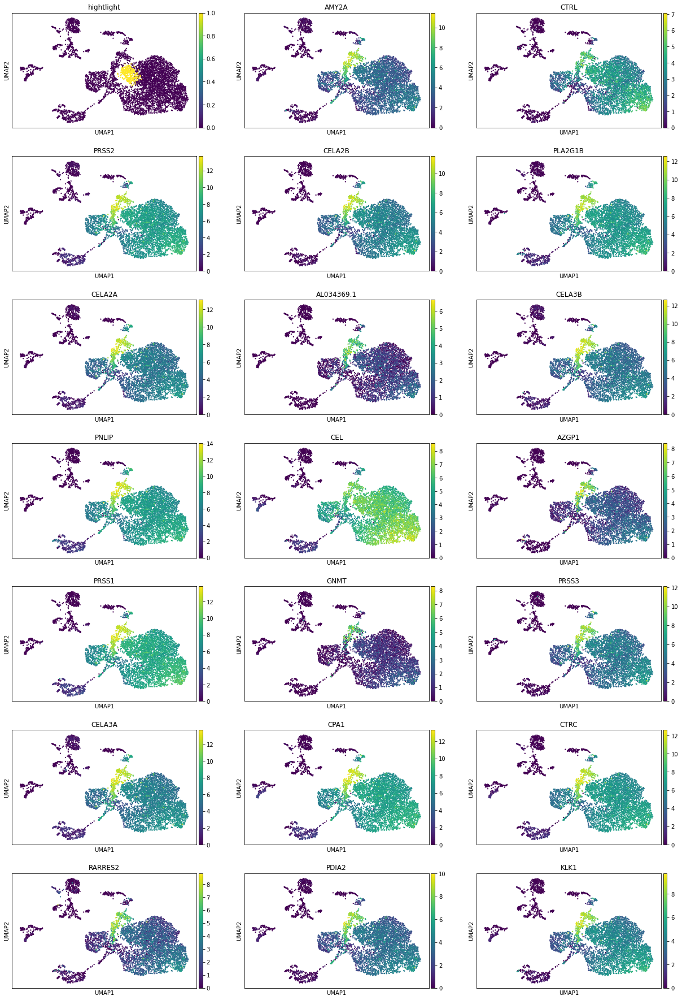

In [27]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


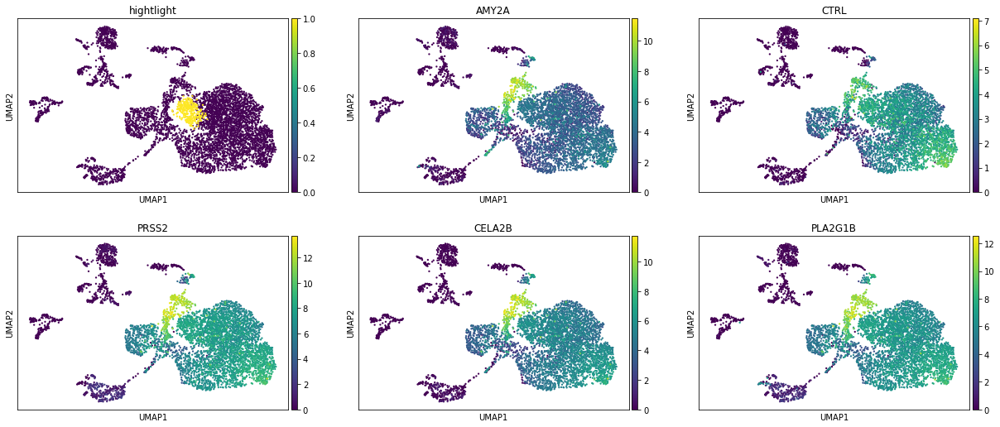

1


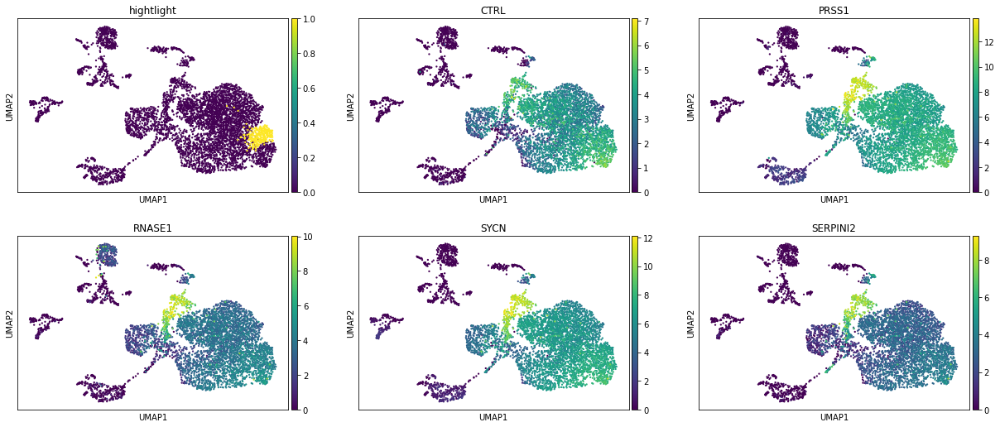

2


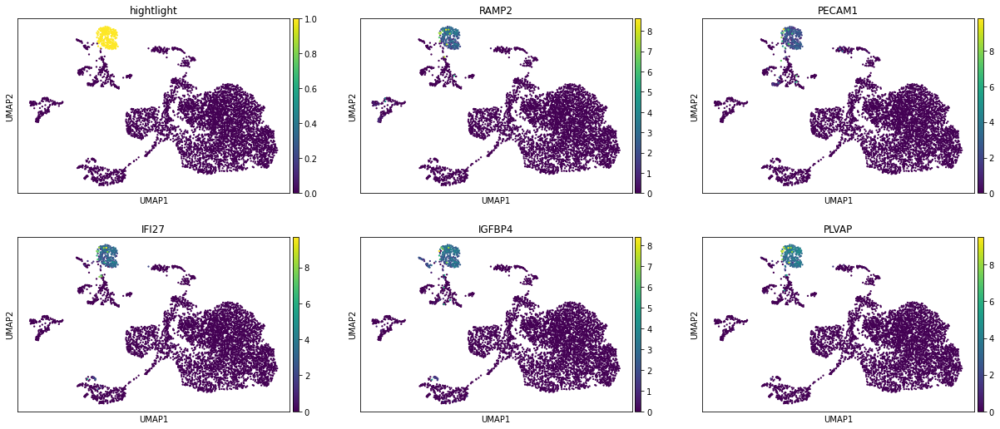

3


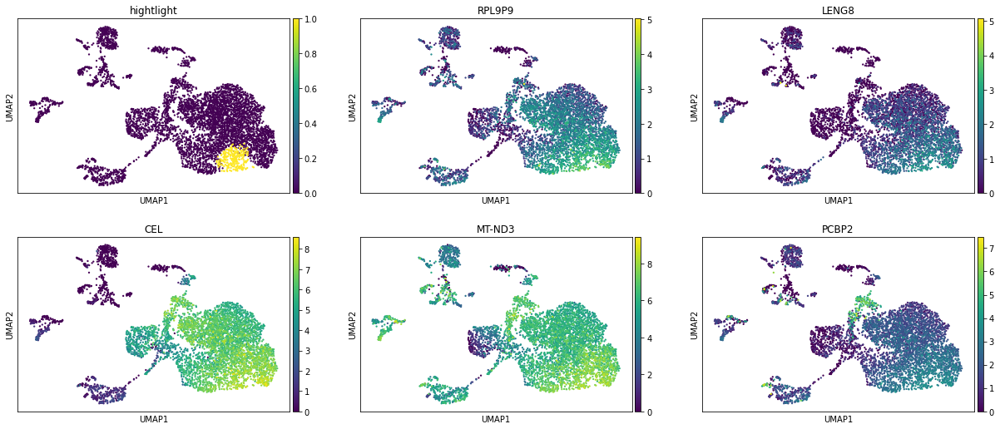

4


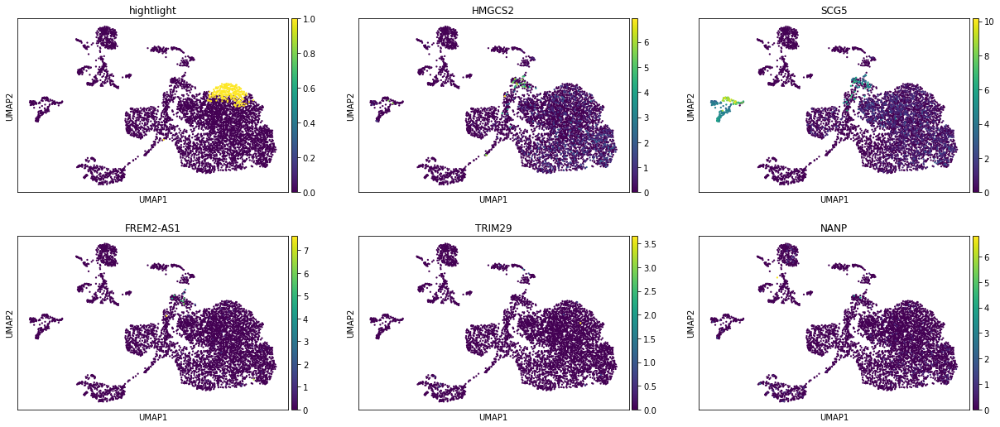

5


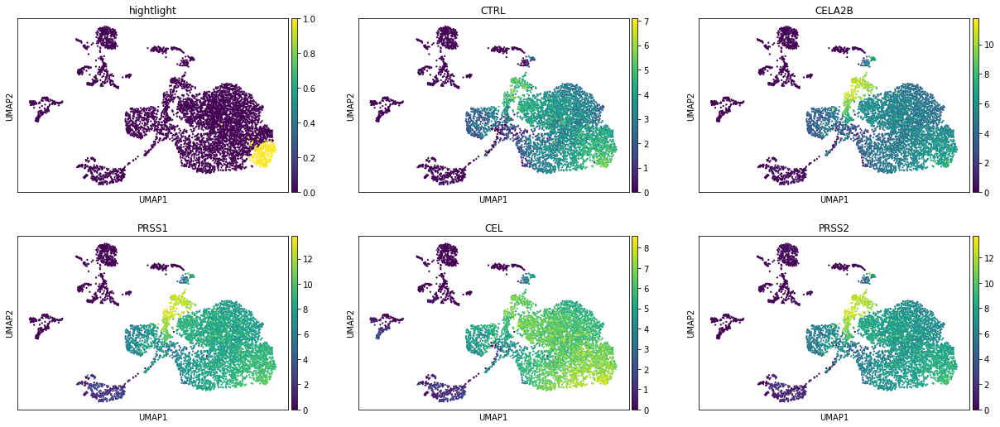

6


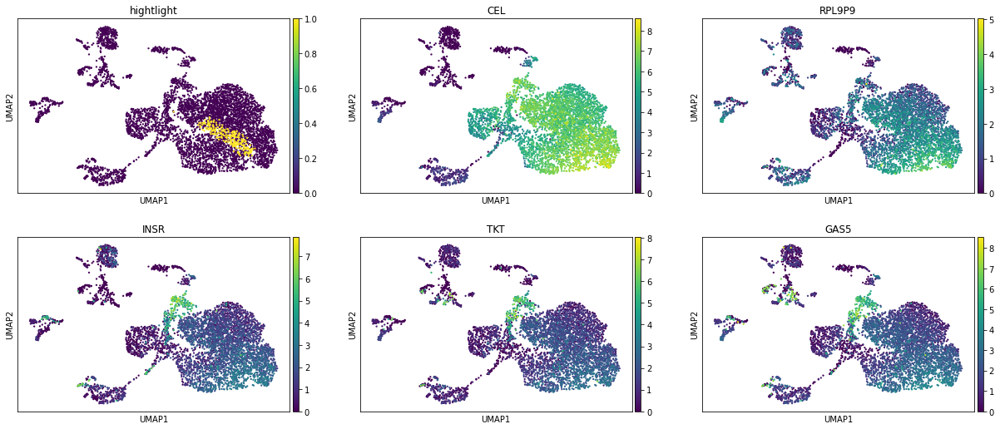

7


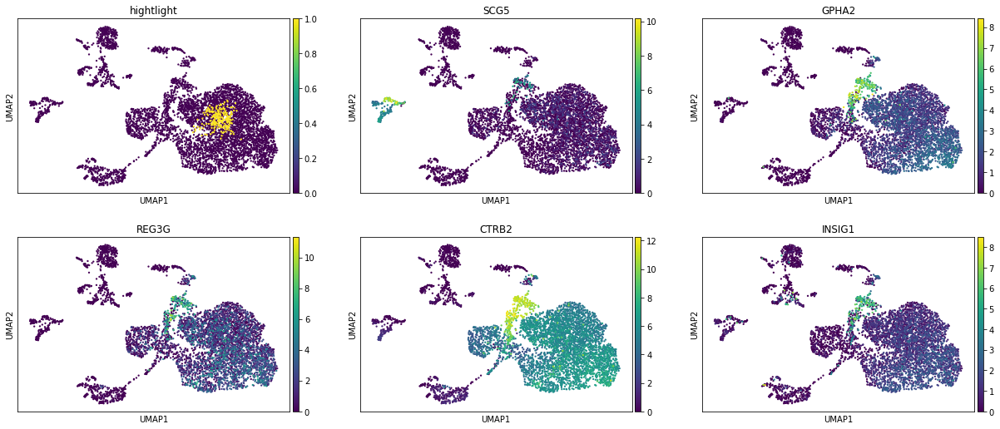

8


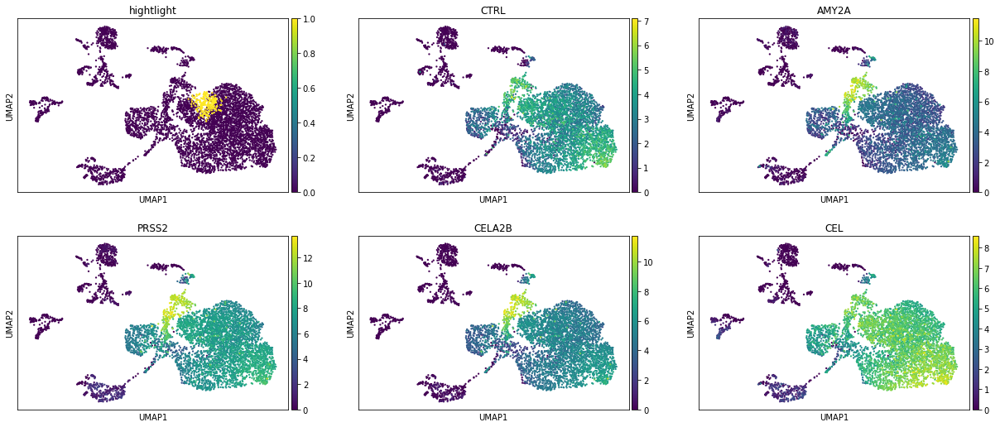

9


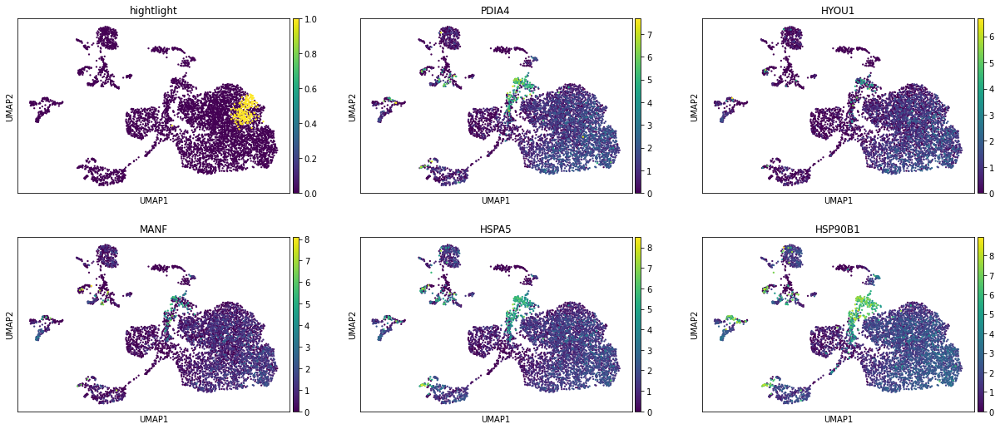

10


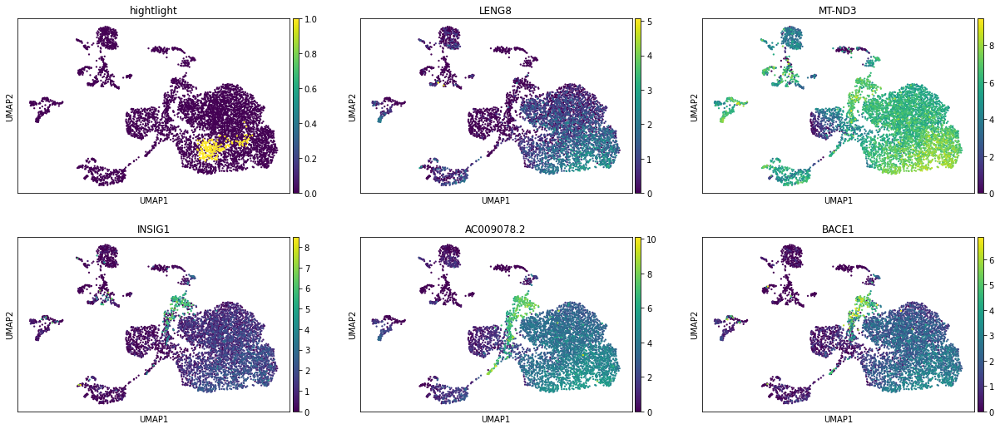

11


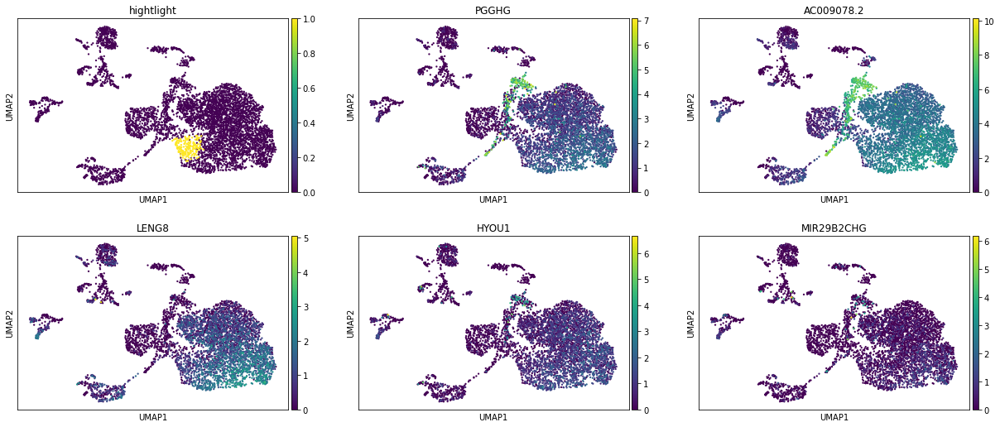

12


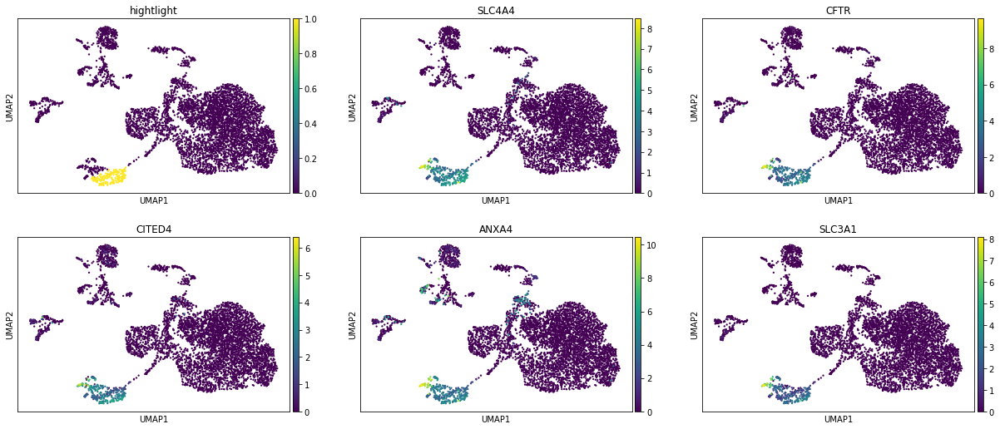

13


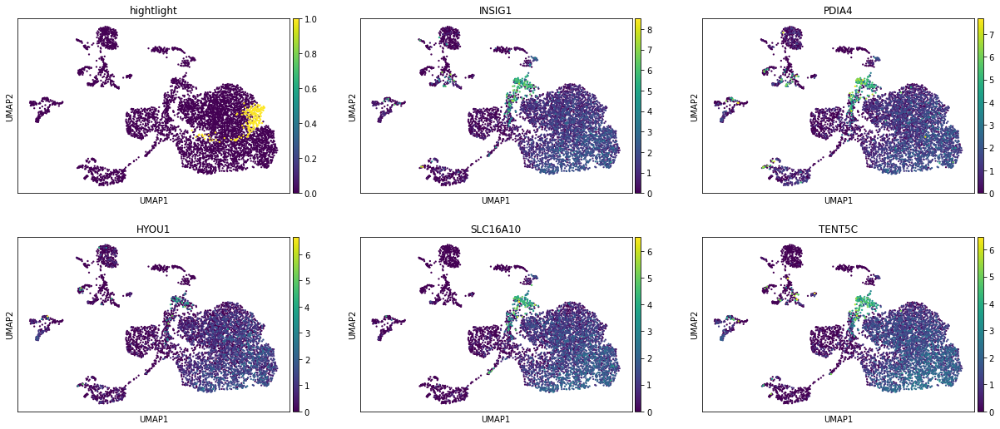

14


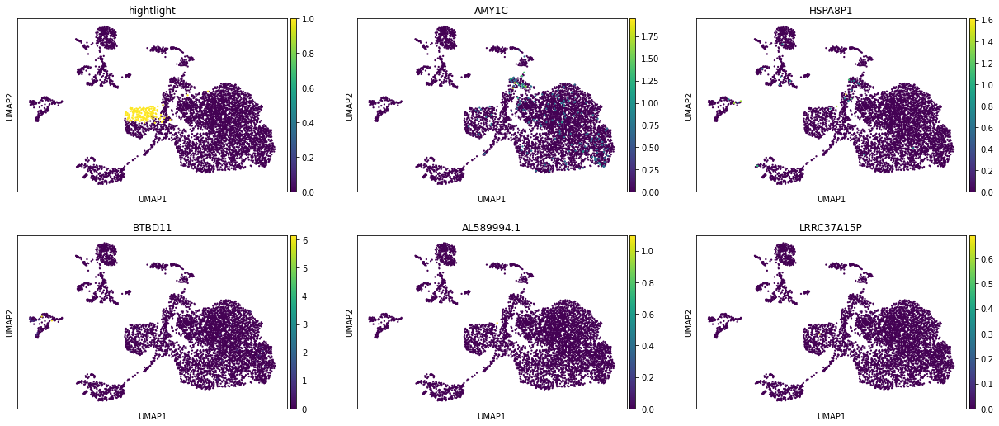

15


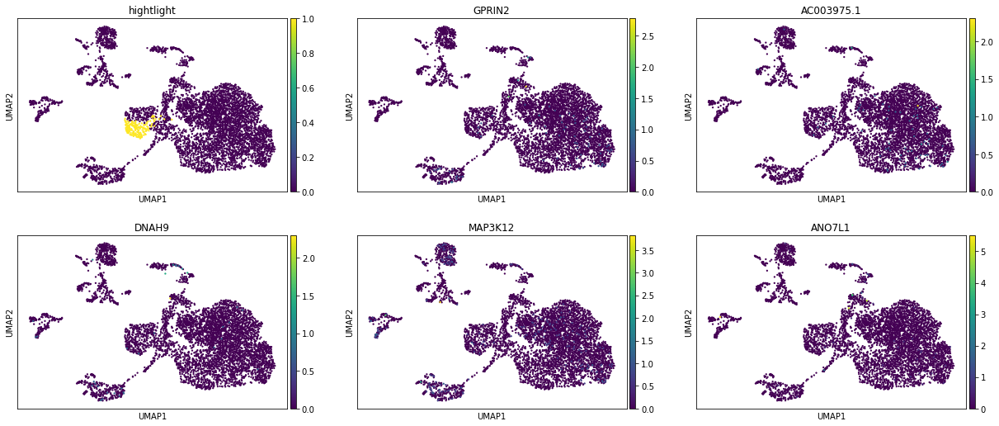

16


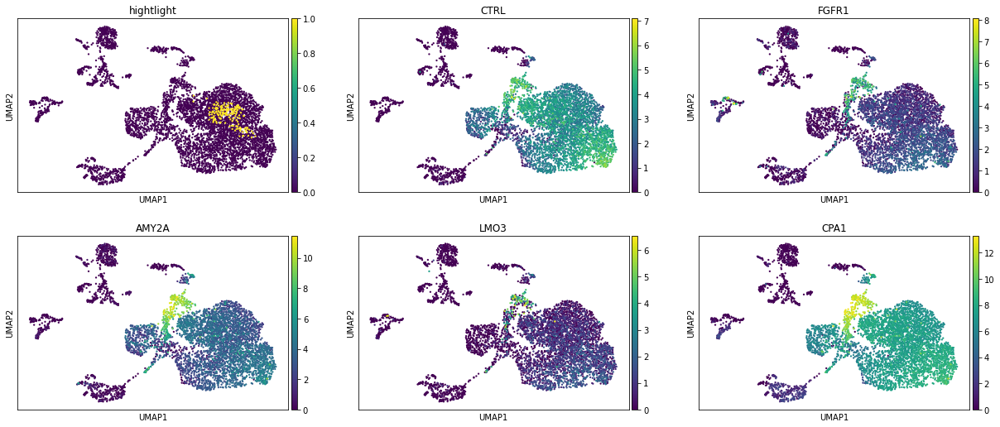

17


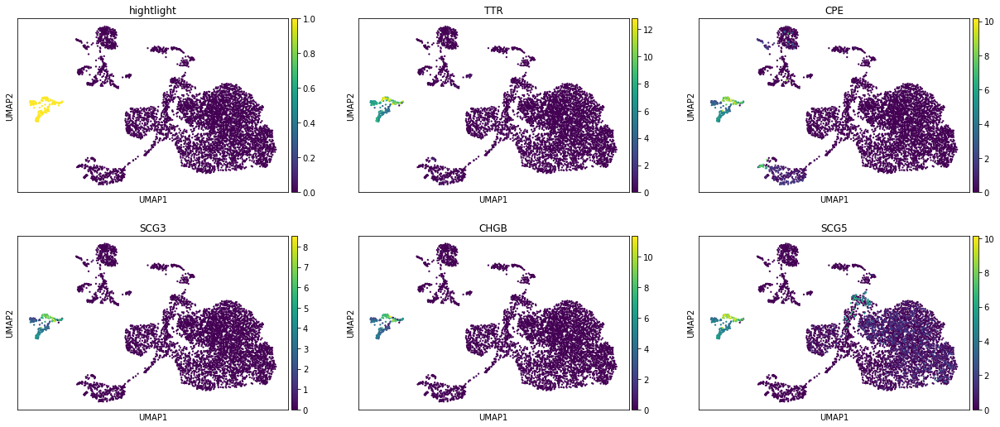

18


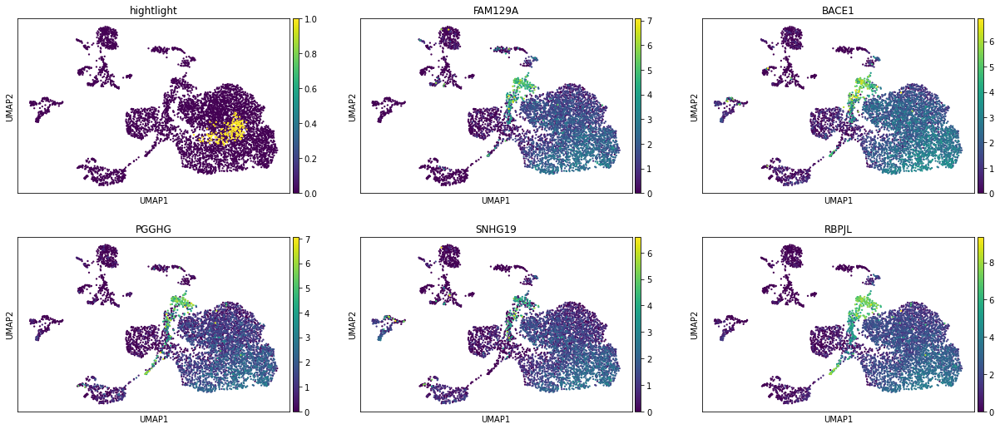

19


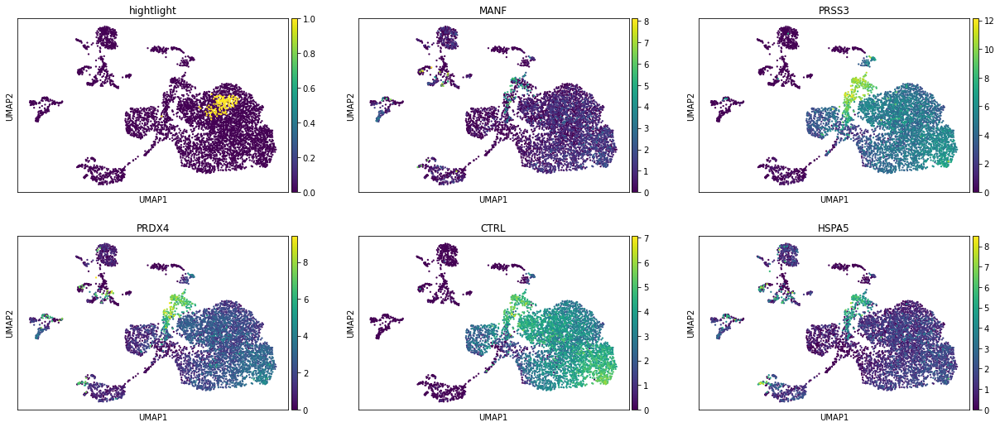

20


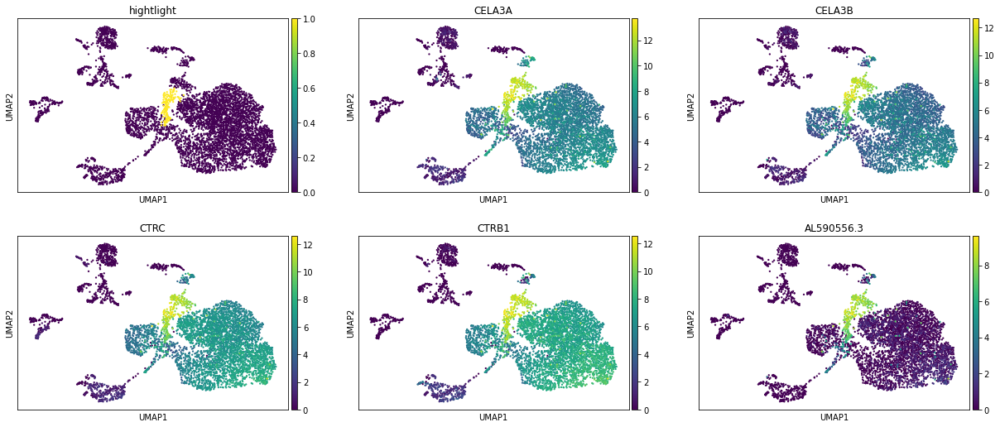

21


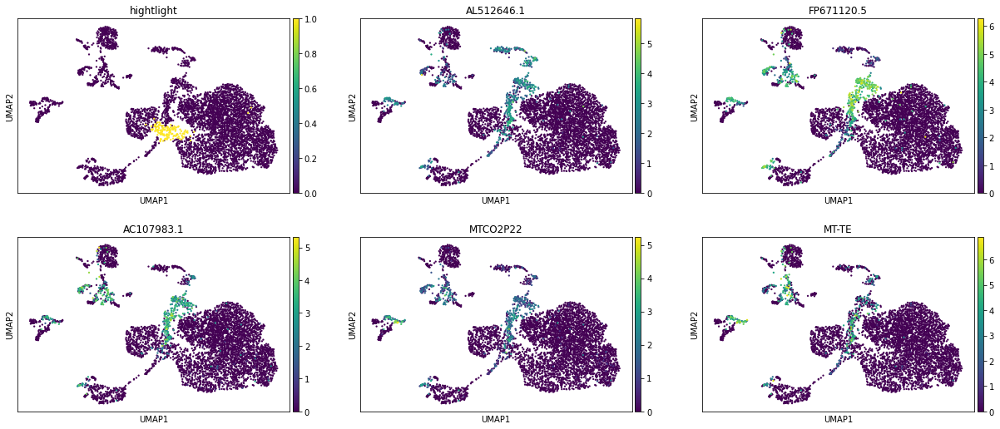

22


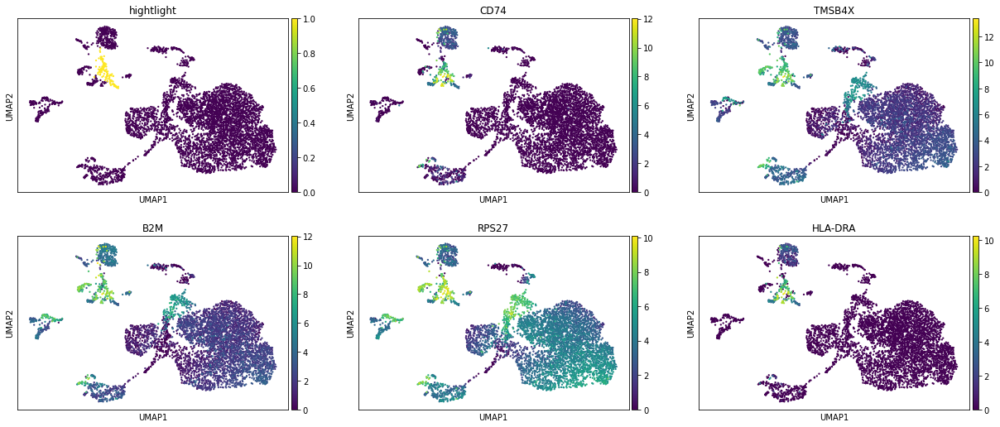

23


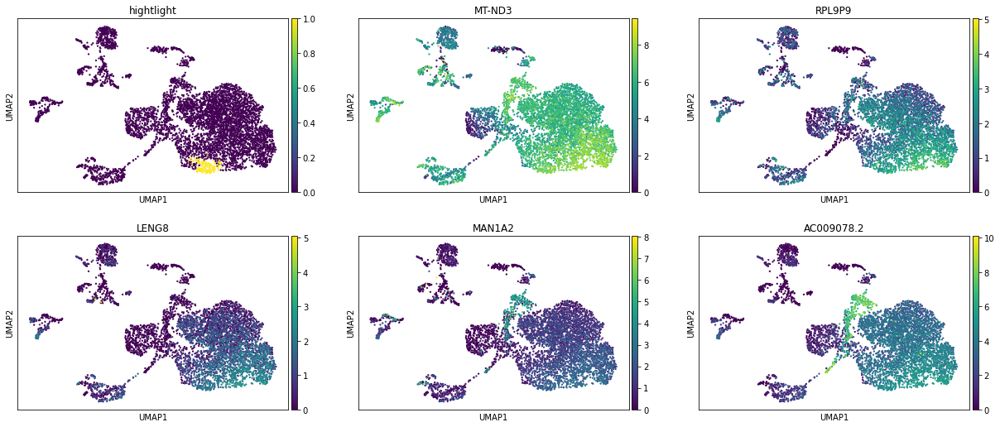

24


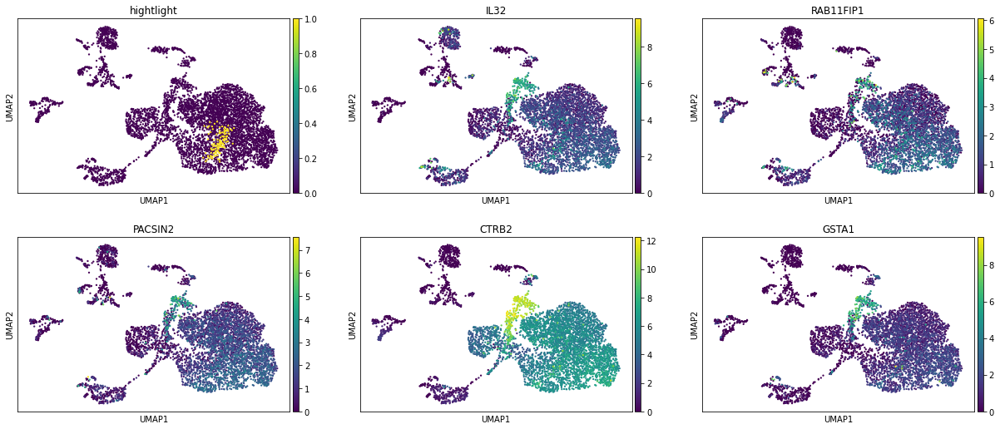

25


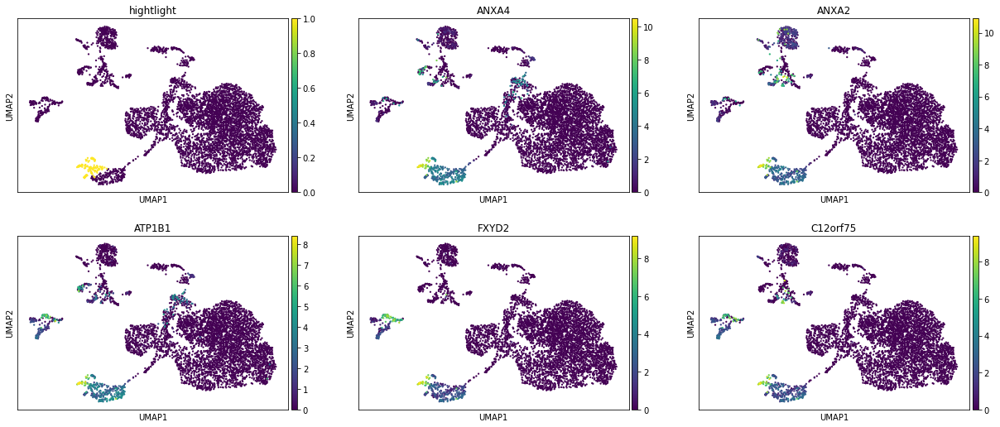

26


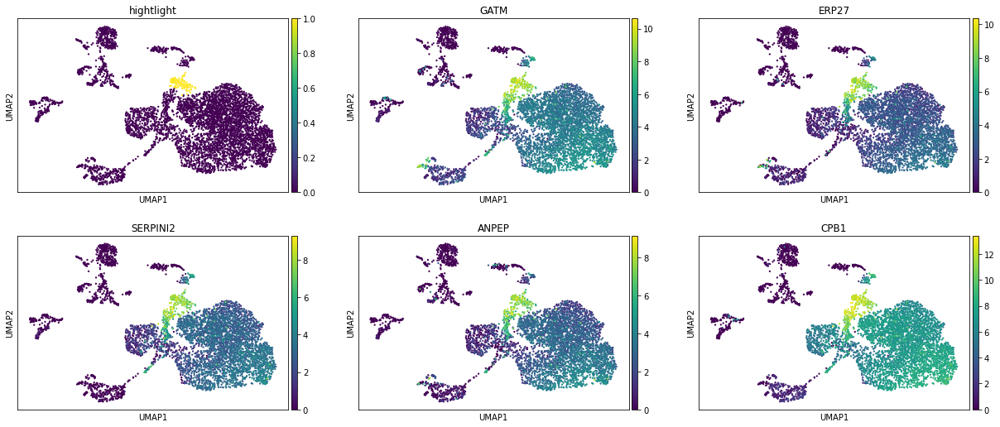

27


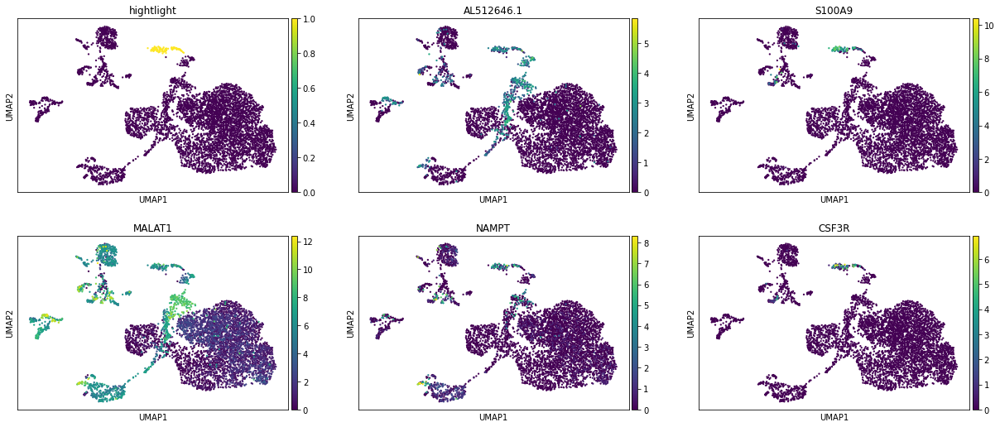

28


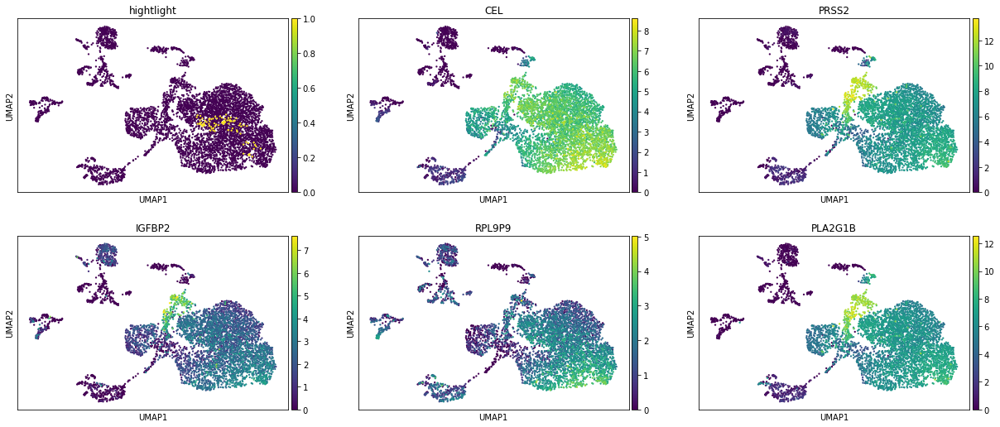

29


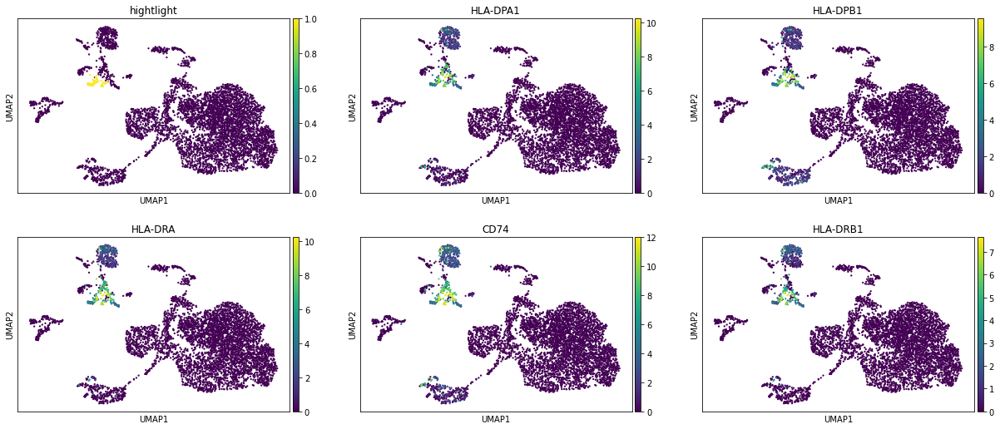

30


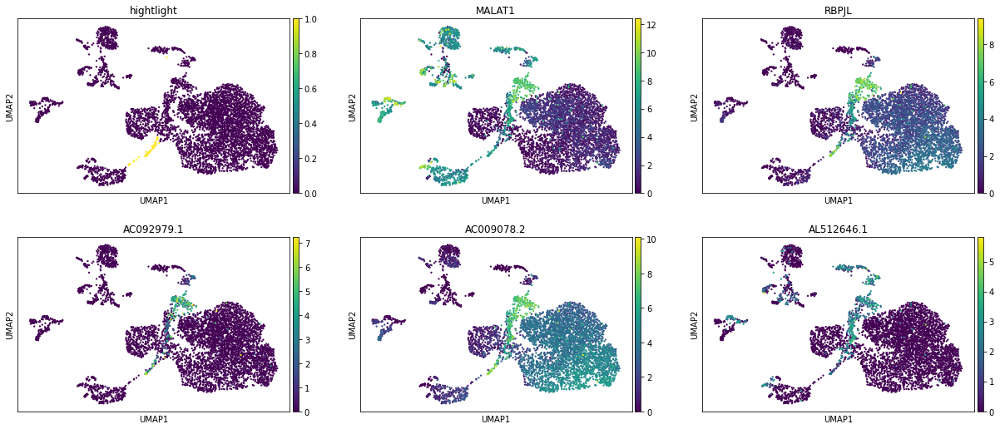

31


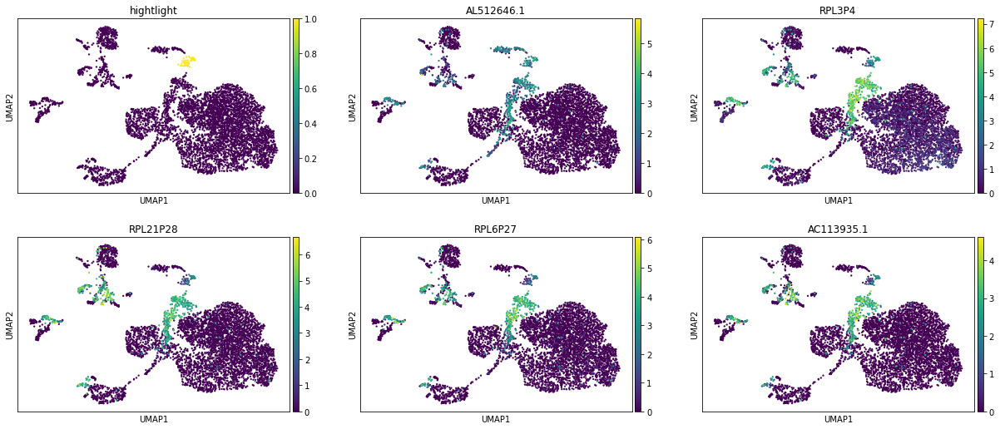

32


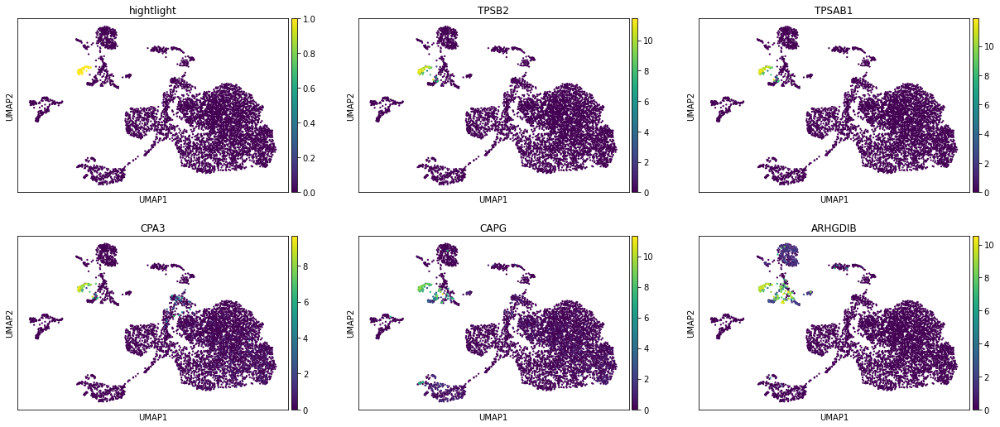

33


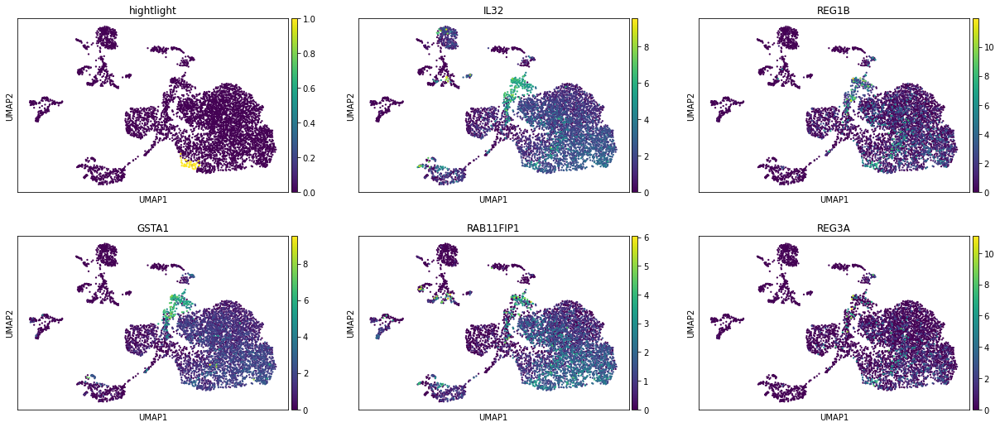

34


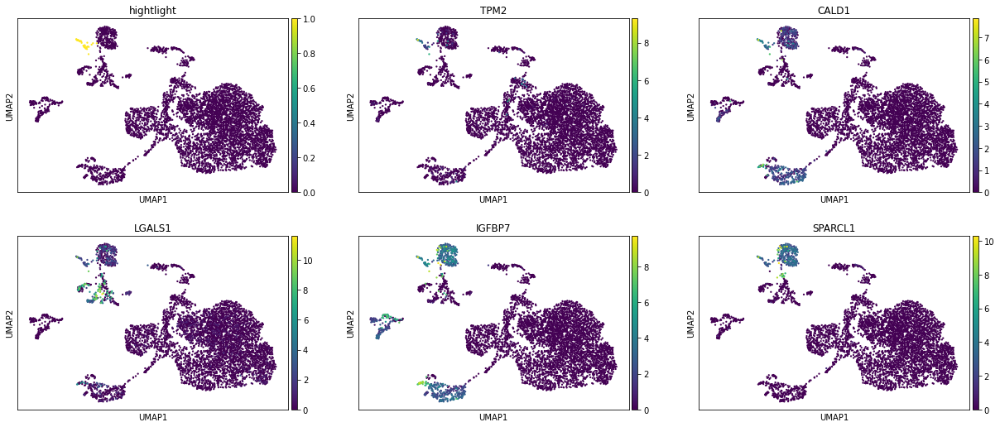

35


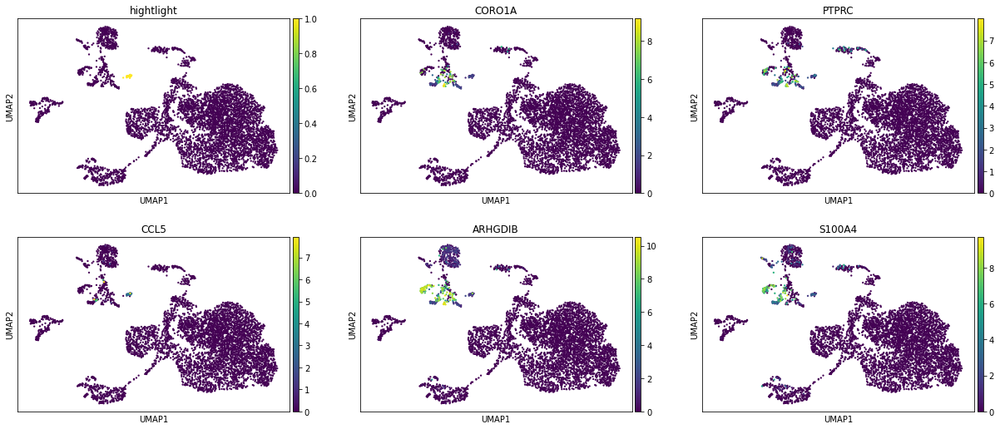

In [28]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [29]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
AMY2A,15.320601,1.699005,3.279080e-48
CTRL,14.726482,1.962728,1.282803e-44
PRSS2,14.331129,2.759146,2.743897e-42
CELA2B,14.157248,2.133706,2.479337e-41
PLA2G1B,13.475057,2.398213,2.582227e-37
...,...,...,...
YWHAB,-5.287242,-1.249089,2.737883e-05
PABPN1,-5.306115,-1.160551,2.497215e-05
LITAF,-5.311987,-2.182678,2.445837e-05
YWHAZ,-6.232485,-1.365088,1.364991e-07


# read in cell ontology 

In [30]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [31]:
celltype_dict["T cell"]

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [32]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD69-positive, CD4-positive single-positive thymocyte',
 'CD4-positive, alpha-beta thymocyte',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD24-positive, CD4 single-positive thymocyte',
 'CD4-positive, alpha-beta T cell',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-positive type I NK T cell',
 'CD4-negative, CD8-negative type I NK T cell',
 'CD4-positive, alpha-beta intraepithelial T cell',
 'central memory CD4-positive, alpha-beta T cell',
 'activated CD4-positive type I NK T cell',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'effector CD4-positive, alpha-beta T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD4-positive type I NK T cell secreting interferon-gamma',
 'naive thymus-derived CD4-positive, alpha-beta T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'activated CD4-negative, CD8-negative type I NK T cell',
 'CD4-positive, CD25-positive, CCR4-pos

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [33]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-0.820505,-0.159696,-0.159696,5.315821
log fold change,-26.730482,-23.812769,-23.095284,0.321123
adjusted pvalue,1.000000,1.000000,1.000000,0.000024


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



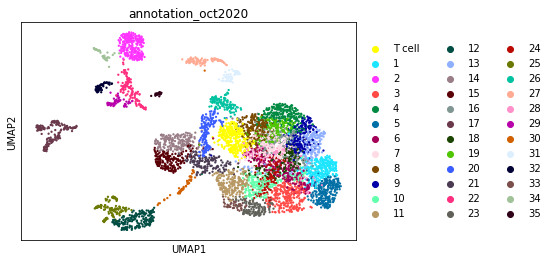

In [35]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# create celltype subcluster
This is just an example once the celltype annotations are done, how to subcluster cells in a celltype

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



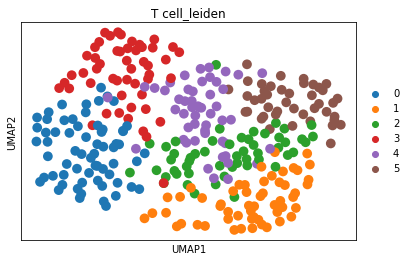

In [36]:
celltype = "T cell"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=1, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype],
    ncols=3,
)

In [37]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

0


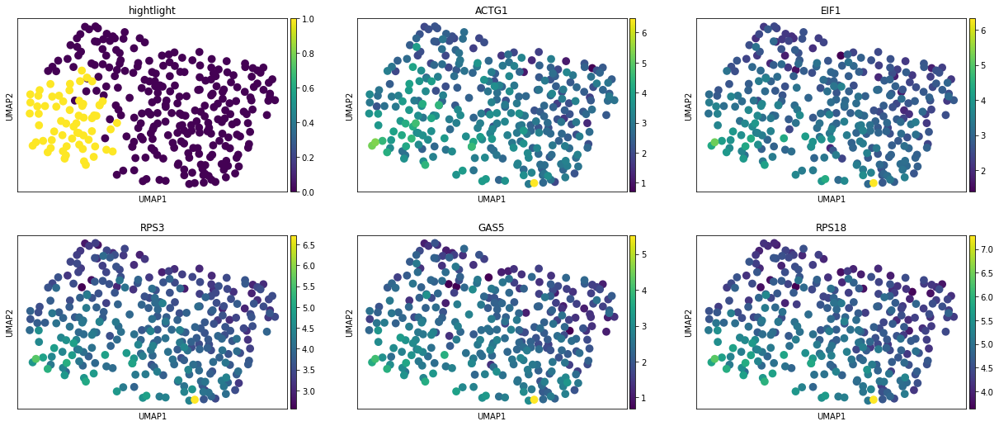

1


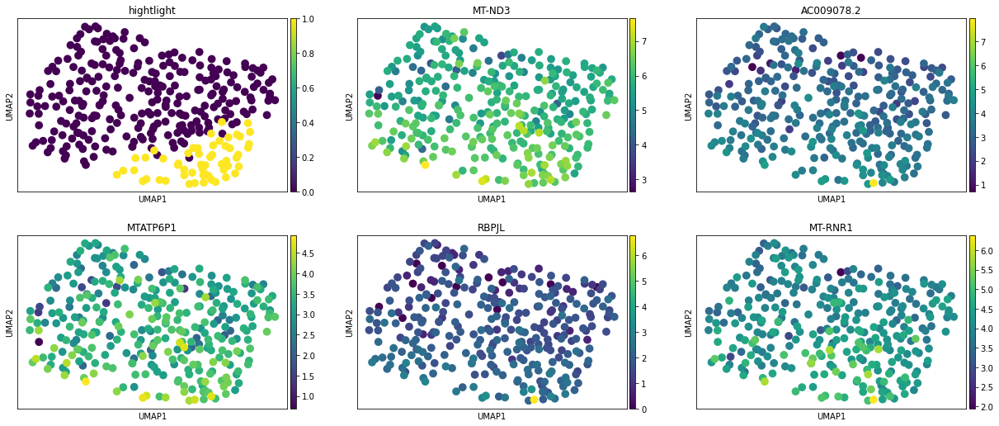

2


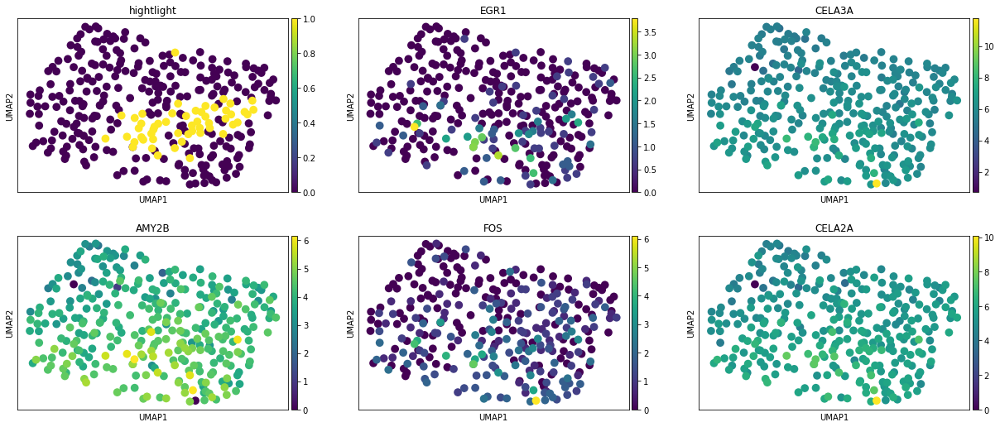

3


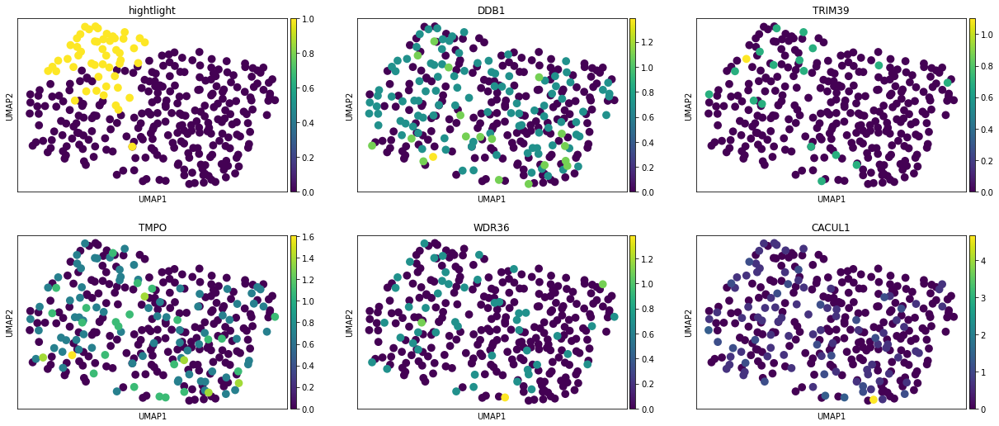

4


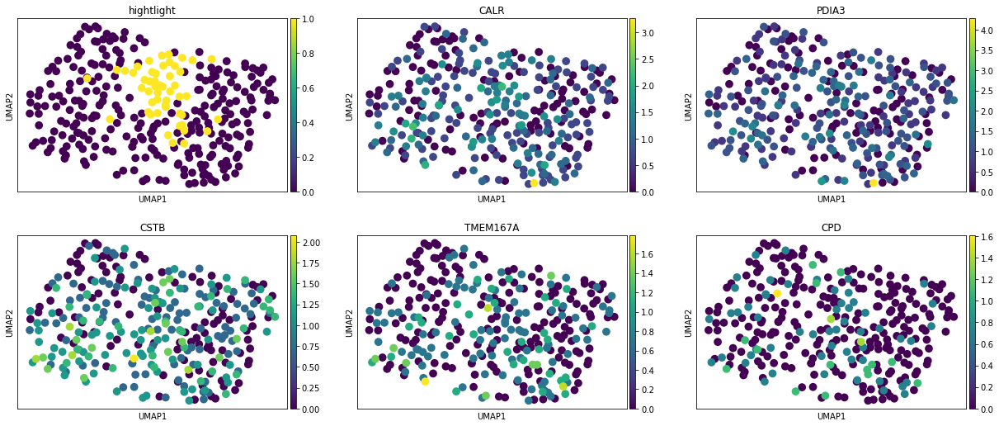

5


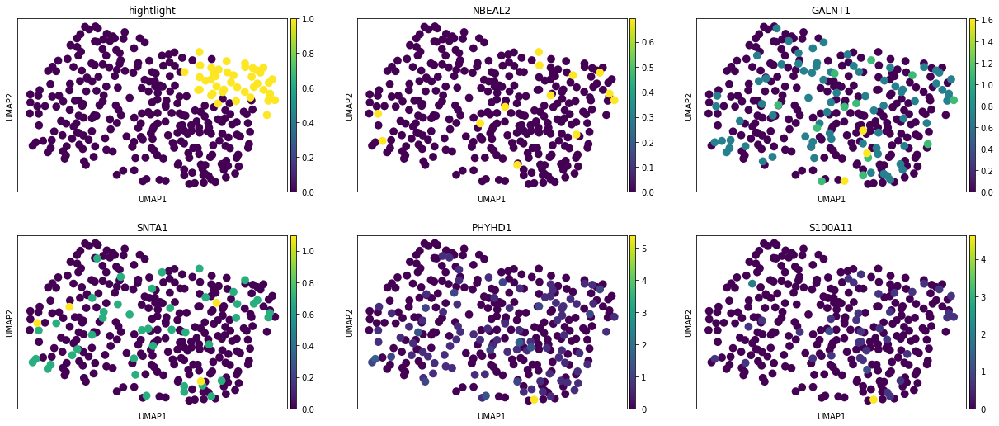

In [38]:
for x in sub_DE.keys():
    print(x)
    topgenes = list(sub_DE[x].T[:5].index)
    sub_organ_adata.obs["hightlight"] = sub_organ_adata.obs["%s_leiden" % celltype] == x
    sc.pl.umap(
        sub_organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

# manually create mapping between cell type and compartment (this is just an example)

In [39]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [40]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

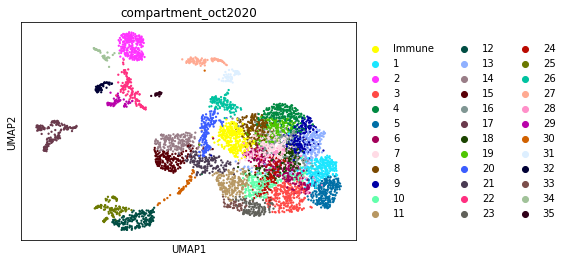

In [41]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [42]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)